## Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

In [2]:
# Import Packages 
import numpy as np
import cv2
import glob
import pickle
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib qt
%matplotlib inline

---
## Camera calibration using chessboard images
---

In [49]:
# Defining Functions 
def camera_calibration(filepath='./camera_cal/'):    
    print('\tcalibration started...')
    
    # prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
    objp = np.zeros((6*9,3), np.float32)
    objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

    # Arrays to store object points and image points from all the images.
    objpoints = [] # 3d points in real world space
    imgpoints = [] # 2d points in image plane.

    # Make a list of calibration images
    images = glob.glob(filepath + 'calibration*.jpg')

    # Step through the list and search for chessboard corners
    for fname in images:
        img = cv2.imread(fname)
        gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

        # Find the chessboard corners
        ret, corners = cv2.findChessboardCorners(gray, (9,6),None)

        # If found, add object points, image points
        if ret == True:
            objpoints.append(objp)
            imgpoints.append(corners)

            # Draw and display the corners
            img = cv2.drawChessboardCorners(img, (9,6), corners, ret)
            cv2.imshow('img',img)
            cv2.waitKey(500)
    cv2.destroyAllWindows()
    cv2.waitKey(1)
    print('\tcalibration done. saving...')
    img = cv2.imread(images[0])
    
    img_size = (img.shape[1], img.shape[0])
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size, None, None)

    dist_pickle = {}
    dist_pickle['mtx'] = mtx
    dist_pickle['dist'] = dist
    pickle.dump(dist_pickle, open('./calibration_pickle.p', 'wb'))

    
def weighted_img(img, initial_img, α=0.8, β=1., γ=0.):
    return cv2.addWeighted(initial_img, α, img, β, γ)


def get_warp_corners(show=False):
    straight_line_images = glob.glob('test_images/straight_*.jpg') 

    i = 1
    for straight_line_image in straight_line_images:
        straight_line_image = mpimg.imread('test_images/straight_lines1.jpg') 
        # [4] Defining a polygon region mask and use that as region of interest for lane detection
        img_width = straight_line_image.shape[1]
        img_height = straight_line_image.shape[0]

        C1 = (int(0.16 * img_width), img_height)
        C2 = (int(0.47 * img_width), int(0.624 * img_height))
        C3 = (int(0.54 * img_width), int(0.624 * img_height))
        C4 = (int(0.87 * img_width), img_height)
        
        if not show:
            break
        
        poly_region = np.copy(straight_line_image)*0
        P1 = (int(0.05 * img_width), img_height)
        P2 = (int(0.45 * img_width), int(0.624 * img_height))
        P3 = (int(0.56 * img_width), int(0.624 * img_height))
        P4 = (int(0.95 * img_width), img_height)
        P5 = (int(0.75 * img_width), P4[1])
        P6 = (int(0.52 * img_width), P3[1])
        P7 = (int(0.49 * img_width), P2[1])
        P8 = (int(0.25 * img_width), P1[1])

        # Uncomment the following lines in case you need to check the polygon region mask
        cv2.line(poly_region,P1,P2,(0,255,0),5)
        cv2.line(poly_region,P2,P3,(0,255,0),5)
        cv2.line(poly_region,P3,P4,(0,255,0),5)
        cv2.line(poly_region,P4,P5,(0,255,0),5)
        cv2.line(poly_region,P5,P6,(0,255,0),5)
        cv2.line(poly_region,P6,P7,(0,255,0),5)
        cv2.line(poly_region,P7,P8,(0,255,0),5)
        cv2.line(poly_region,P8,P1,(0,255,0),5)

        # Uncomment the following lines in case you need to check the polygon region mask
        cv2.line(poly_region,C1,C2,(255,0,0),2)
        cv2.line(poly_region,C3,C4,(255,0,0),2)

        # In case you need to check the mask region
        lines_edges = weighted_img(poly_region, straight_line_image, 0.8, 1., 0.)

        plt.figure(figsize=(80, 60)) 
        plt.subplot(len(straight_line_images), 1, i)
        plt.imshow(lines_edges)
        plt.axis('on')
        plt.show()
        i += 1
    dist_pickle = pickle.load(open('./calibration_pickle.p', 'rb'))
#     dist_pickle['warp_corners'] = [list(C1), list(C2), list(C3), list(C4)]
    dist_pickle['warp_corners'] = [[220, 720], [597, 449], [687, 449], [1113, 720]] 
    pickle.dump(dist_pickle, open('./calibration_pickle.p', 'wb'))
    
    return [list(C1), list(C2), list(C3), list(C4)]
    
    
def sobel_hls_threshold(img, sobel_kernel=9, h_thresh=(5, 100), s_thresh=(90, 255), sx_thresh=(60, 100)):
    # Convert to HLS color space and separate the S channel
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    h_channel = hls[:,:,0]
    s_channel = hls[:,:,2]
    
    # Grayscale image
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

    # Sobel x
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobelx = np.uint8(255*abs_sobelx/np.max(abs_sobelx))

    # Threshold x gradient
    sxbinary = np.zeros_like(scaled_sobelx)
    sxbinary[(scaled_sobelx >= sx_thresh[0]) & (scaled_sobelx <= sx_thresh[1])] = 1
    
    # Threshold color channel
    h_binary = np.zeros_like(h_channel)
    h_binary[(h_channel >= h_thresh[0]) & (h_channel <= h_thresh[1])] = 1
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    # Stack each channel
    color_binary = np.dstack((h_binary, sxbinary, s_binary)) * 255

    # Combine the two binary thresholds
    combined_binary = np.zeros_like(sxbinary)
    combined_binary[((h_binary == 1) & (s_binary == 1)) | (sxbinary == 1)] = 1

    return color_binary, combined_binary


def region_of_interest(img, vertices):
    """
    Applies an image mask.
    
    Only keeps the region of the image defined by the polygon
    formed from `vertices`. The rest of the image is set to black.
    `vertices` should be a numpy array of integer points.
    """
    # Defining a blank mask to start with
    mask = np.zeros_like(img)   
    
    # Defining a 3-channel or 1-channel color to fill the mask with depending on the input image
    if len(img.shape) > 2:
        channel_count = img.shape[2]  # i.e. 3 or 4 depending on your image
        ignore_mask_color = (255,) * channel_count
    else:
        ignore_mask_color = 255
        
    # Filling pixels inside the polygon defined by "vertices" with the fill color    
    cv2.fillPoly(mask, vertices, ignore_mask_color)
    
    # Returning the image only where mask pixels are nonzero
    masked_image = cv2.bitwise_and(img, mask)
    
    # Uncomment the following line in case you want to see the masked result in grayscale  
    # plt.imshow(masked_image, cmap='gray')
    return masked_image



def road_overlay(warped):
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0])) 
    # Combine the result with the original image
    result = cv2.addWeighted(undist, 1, newwarp, 0.3, 0)
    result = cv2.putText(result, f'Radius of Curvature = {0}(m)\nVehicle is{0}(m) left of center', org, font,  
                   fontScale, color, thickness, cv2.LINE_AA) 
    
    plt.imshow(result)
    
    
def corners_unwarp(img, mtx, dist, src_corners, dst_corners=None):
    # Use the OpenCV undistort() function to remove distortion
    undist = cv2.undistort(img, mtx, dist, None, mtx)

    img_size = (img.shape[1], img.shape[0])

    # For source points I'm grabbing the outer four detected corners
    src = np.float32(src_corners)
    # For destination points, I'm arbitrarily choosing some points to be
    # a nice fit for displaying our warped result 
    # again, not exact, but close enough for our purposes
    if not dst_corners:
        dst = np.float32([[img_size[0]//4, img_size[1]], [img_size[0]//4, 0], 
                                 [img_size[0]*3//4, 0], 
                                 [img_size[0]*3//4, img_size[1]]])

        
    # Given src and dst points, calculate the perspective transform matrix
    M = cv2.getPerspectiveTransform(src, dst)
    # Warp the image using OpenCV warpPerspective()
    warped = cv2.warpPerspective(undist, M, img_size)

    # Return the resulting image and matrix
    return warped, M


def check_correctness_corners_unwarp():
    # test_images = glob.glob('test_images/*.jpg')
    # test_image = mpimg.imread(test_images[0]) 
    straight_line_images = glob.glob('test_images/straight_*.jpg')
    straight_line_image = mpimg.imread(straight_line_images[1])
    top_down, perspective_M = corners_unwarp(straight_line_image, mtx, dist, warp_corners)

    img_size = (straight_line_image.shape[1], straight_line_image.shape[0])

    warp_corners_ = [tuple(item) for item in warp_corners]

    poly_region = np.copy(straight_line_image)*0
    cv2.line(poly_region,warp_corners_[0],warp_corners_[1],(0,255,0),2)
    cv2.line(poly_region,warp_corners_[2],warp_corners_[3],(0,255,0),2)
    test_image2 = weighted_img(poly_region, straight_line_image, 0.8, 1., 0.)


    dst_corners_ = [[img_size[0]//4, img_size[1]], [img_size[0]//4, 0], [img_size[0]*3//4, 0], [img_size[0]*3//4, img_size[1]]]
    dst_corners_ = [tuple(item) for item in dst_corners_]

    poly_region2 = np.copy(straight_line_image)*0
    cv2.line(poly_region2,dst_corners_[0],dst_corners_[1],(0,255,0),2)
    cv2.line(poly_region2,dst_corners_[2],dst_corners_[3],(0,255,0),2)
    top_down2 = weighted_img(poly_region2, top_down, 0.8, 1., 0.)

    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(test_image2)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(top_down2)
    ax2.set_title('Undistorted and Warped Image', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

    print(warp_corners)
    
    
def find_lane_pixels(binary_warped):
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 20
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),
        (win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),
        (win_xright_high,win_y_high),(0,255,0), 2) 
        
        # Identify the nonzero pixels in x and y within the window #
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        pass

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    return leftx, lefty, rightx, righty, out_img


def fit_polynomial(binary_warped):
    global ploty, left_fit, right_fit
    
    # Find our lane pixels first
    leftx, lefty, rightx, righty, out_img = find_lane_pixels(binary_warped)

    # Fit a second order polynomial to each using `np.polyfit`
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
        print('The function failed to fit a line!')
        left_fitx = 1*ploty**2 + 1*ploty
        right_fitx = 1*ploty**2 + 1*ploty

    ## Visualization ##
    # Colors in the left and right lane regions
    out_img[lefty, leftx] = [255, 0, 0]
    out_img[righty, rightx] = [0, 0, 255]

    # Plots the left and right polynomials on the lane lines
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')

    return out_img




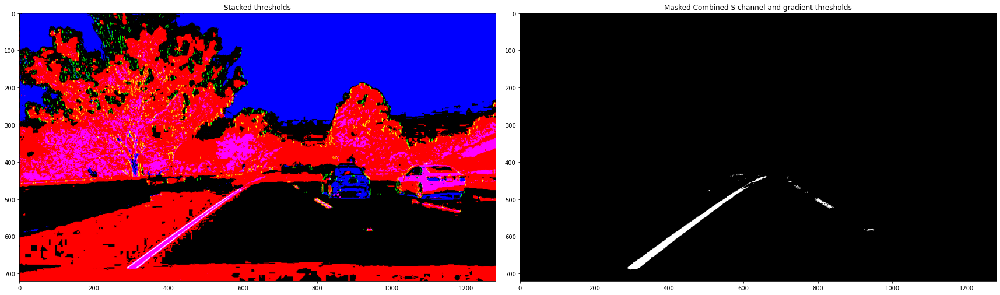

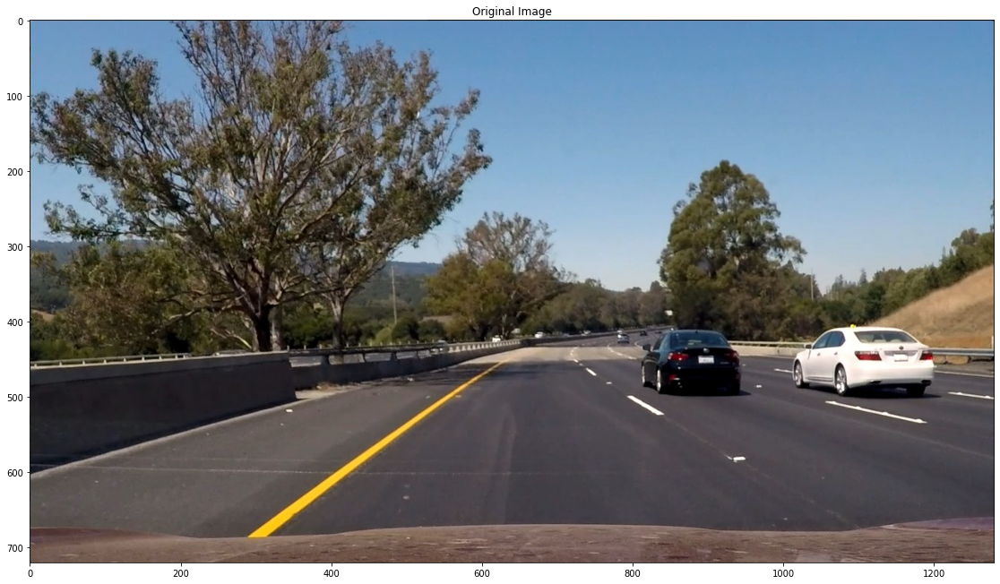

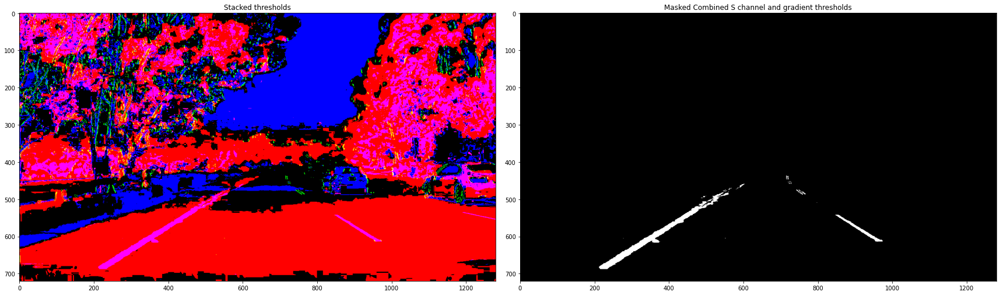

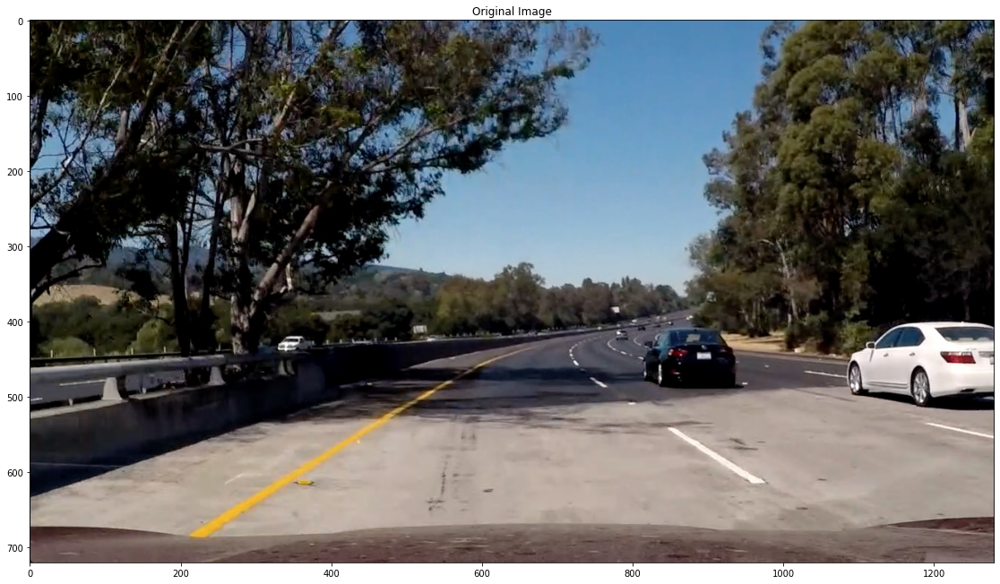

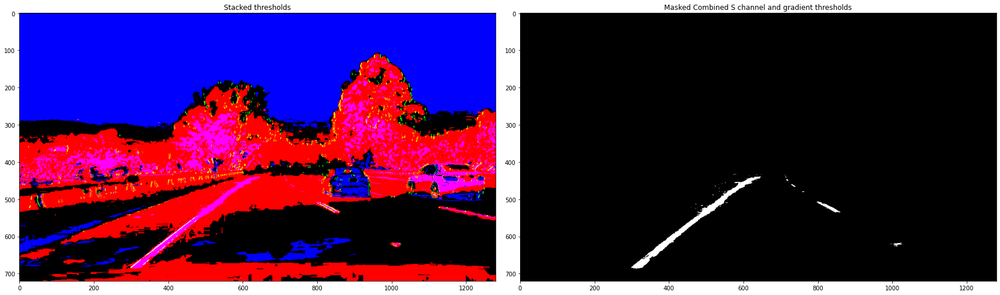

...

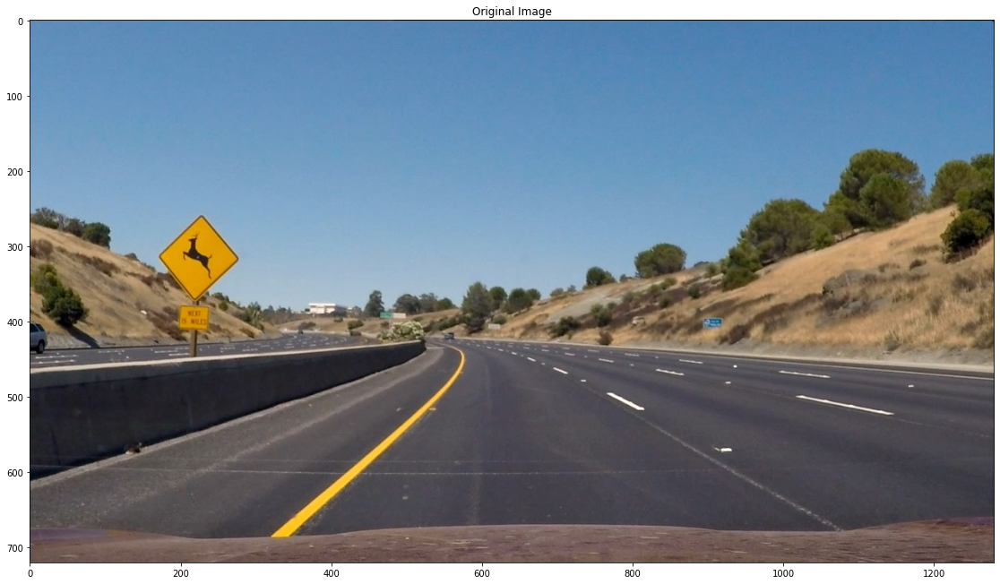

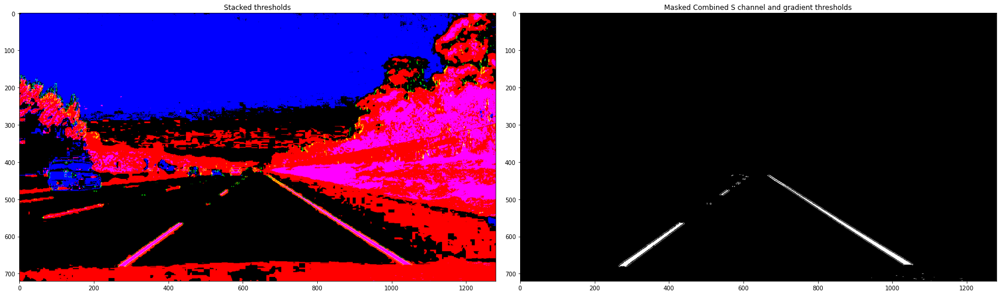

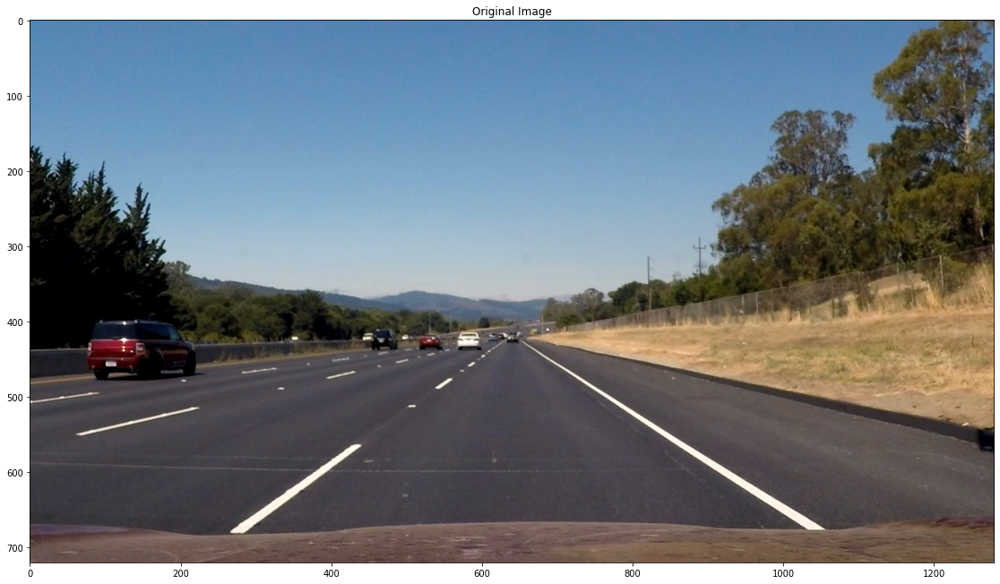

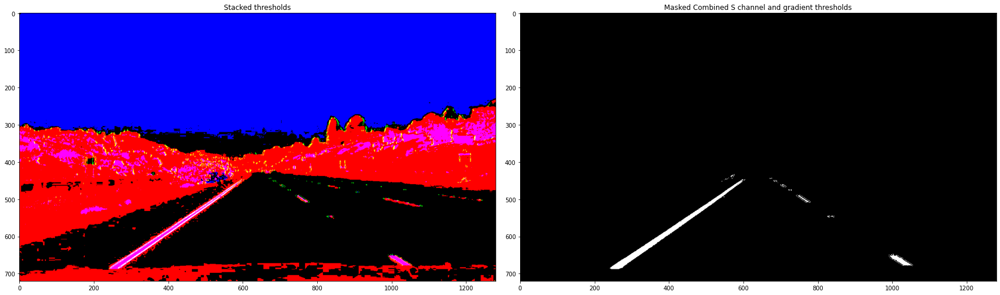

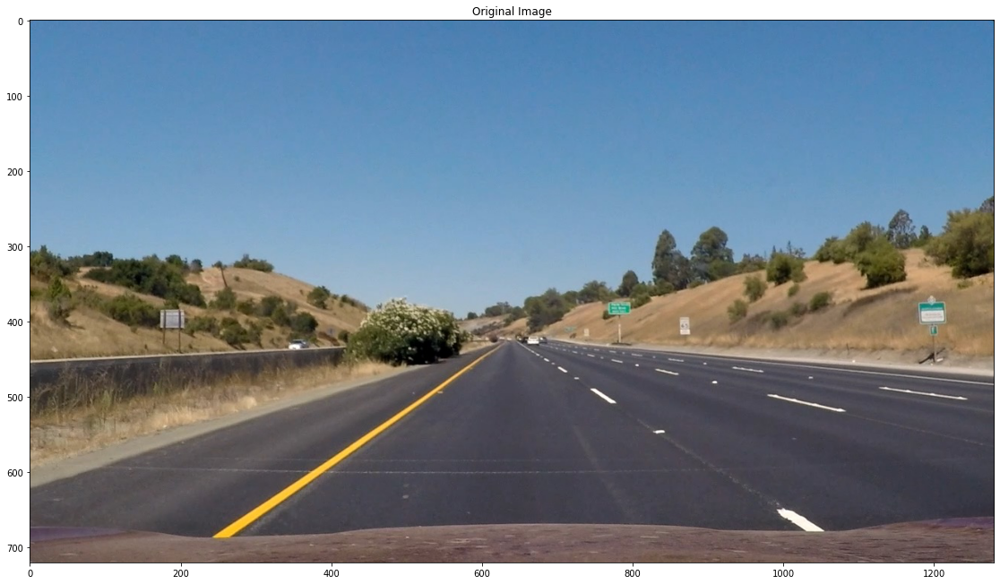

In [8]:
# Checking masked binary outputs after color and xmag thresholding
images = glob.glob('test_images/*.jpg')

image = mpimg.imread(images[0]) 

img_width = image.shape[1]
img_height = image.shape[0]

# [4] Defining a polygon region mask and use that as region of interest for lane detection
poly_region = np.copy(image)*0
P1 = (int(0.05 * img_width), img_height)
P2 = (int(0.45 * img_width), int(0.6 * img_height))
P3 = (int(0.56 * img_width), int(0.6 * img_height))
P4 = (int(0.95 * img_width), img_height)
P5 = (int(0.75 * img_width), P4[1])
# P6 = (int(0.52 * img_width), P3[1])
# P7 = (int(0.49 * img_width), P2[1])
P6 = (int(0.52 * img_width), int(0.8 * img_height))
P7 = (int(0.49 * img_width), P6[1])
P8 = (int(0.25 * img_width), P1[1])
vertices = np.array([[P1, P2, P3, P4, P5, P6, P7, P8, P1]], dtype=np.int32)


for img in images:
    image = mpimg.imread(img) 
    result, result_binary = sobel_hls_threshold(image, h_thresh=(5, 100), s_thresh=(90, 255), sx_thresh=(60, 100))
    masked_image_binary = region_of_interest(result_binary, vertices)
    
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
        
    ax1.set_title('Stacked thresholds')
    ax1.imshow(result)

    ax2.set_title('Masked Combined S channel and gradient thresholds')
    ax2.imshow(masked_image_binary, cmap='gray')
    
    f2, (ax3) = plt.subplots(1, 1, figsize=(24, 9))
    f2.tight_layout()
        
    ax3.set_title('Original Image')
    ax3.imshow(image)

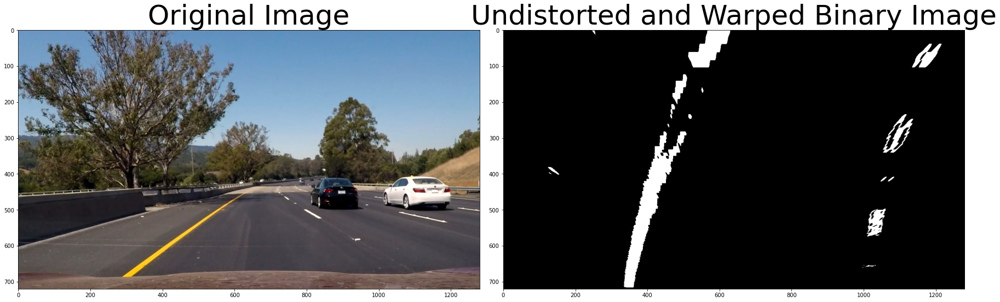

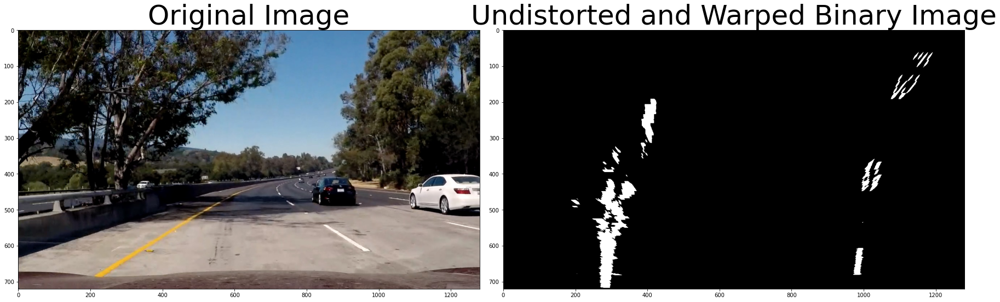

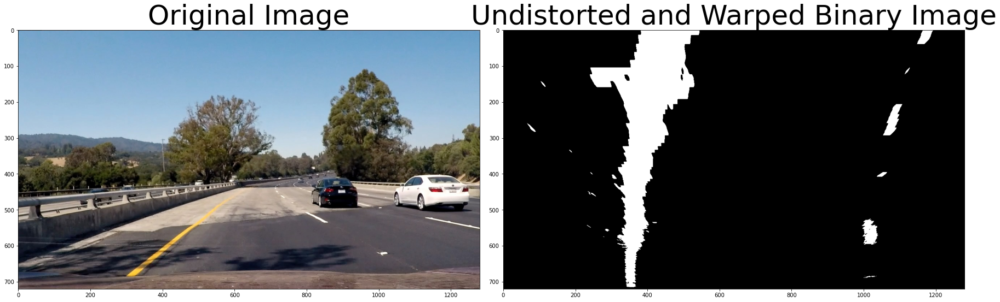

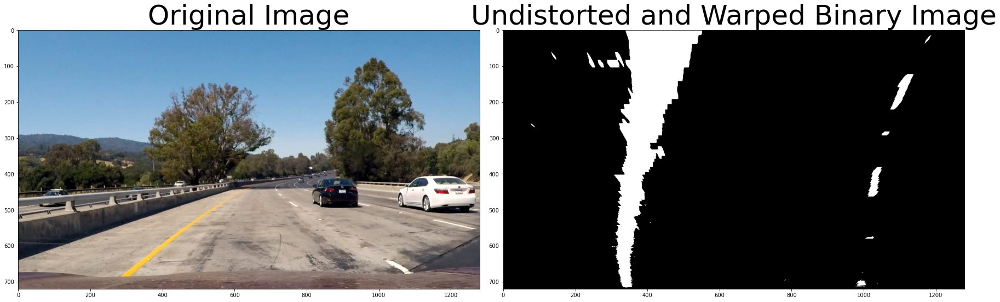

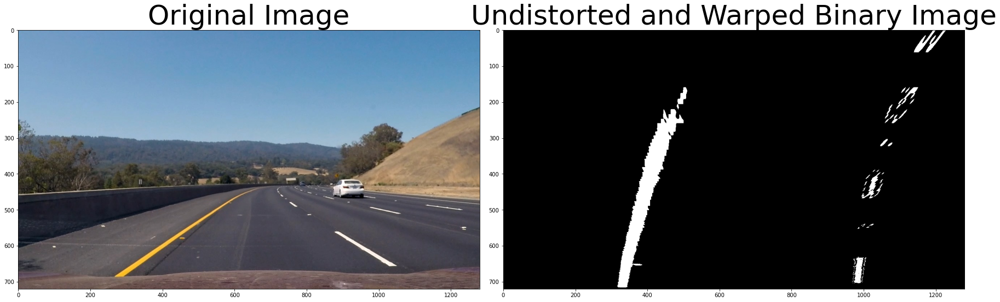

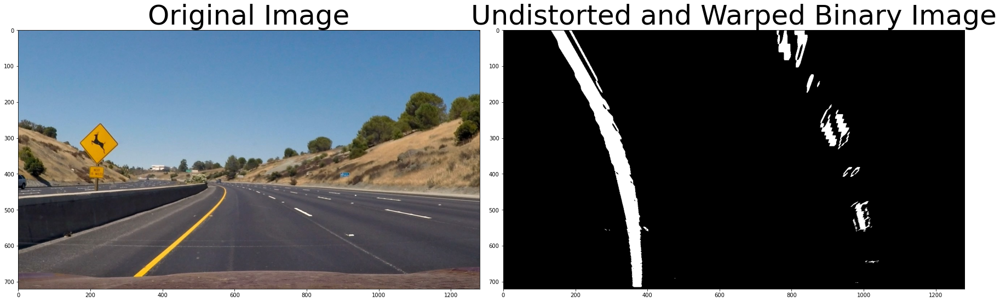

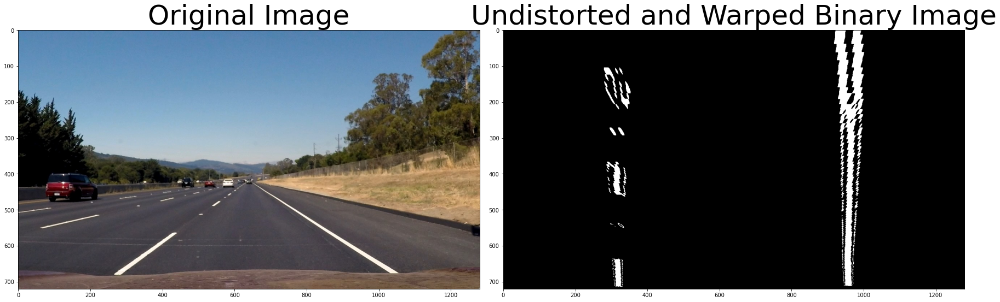

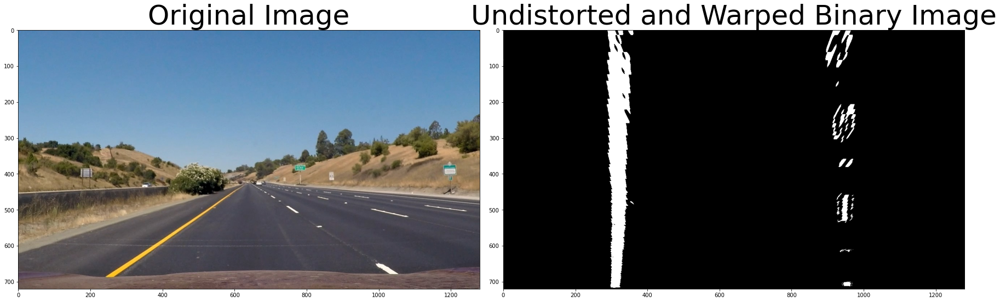

In [15]:
# Checking "warped" masked binary outputs after color and xmag thresholding
images = glob.glob('test_images/*.jpg')
image = mpimg.imread(images[0]) 

img_size = (image.shape[1], image.shape[0])

for image in images:
    img = mpimg.imread(image)
    
    result, result_binary = sobel_hls_threshold(img)
    
    masked_image_binary = region_of_interest(result_binary, vertices)

    top_down, perspective_M = corners_unwarp(masked_image_binary, mtx, dist, warp_corners)
    
#     warp_corners_ = [tuple(item) for item in warp_corners]

    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(top_down, cmap='gray')
    ax2.set_title('Undistorted and Warped Binary Image', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

[[220, 720], [597, 449], [687, 449], [1113, 720]]


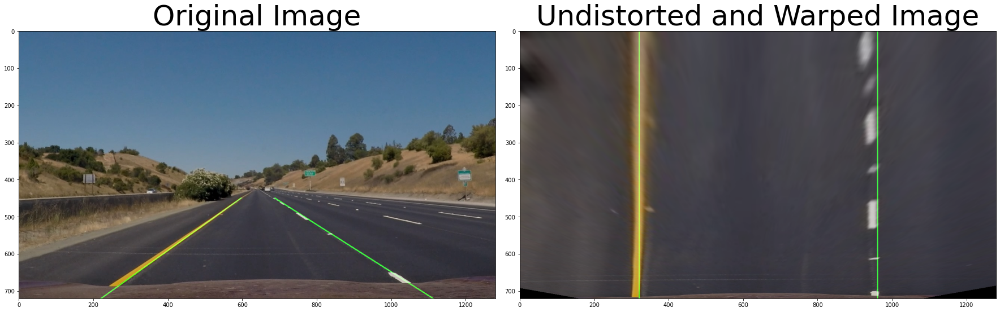

In [14]:
check_correctness_corners_unwarp()

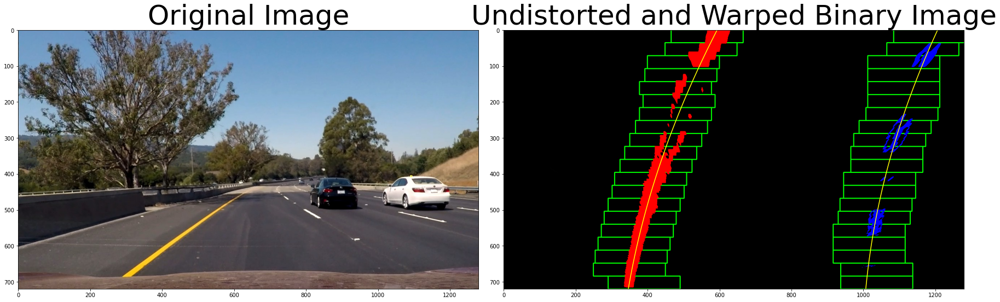

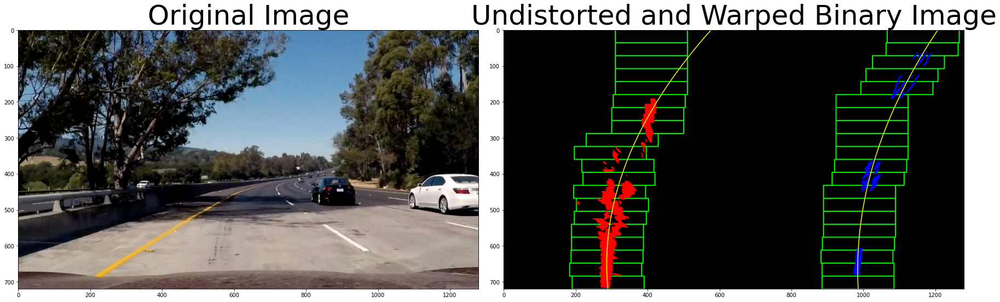

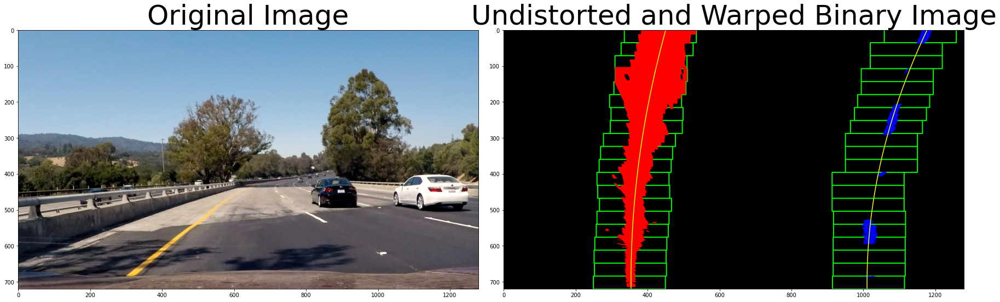

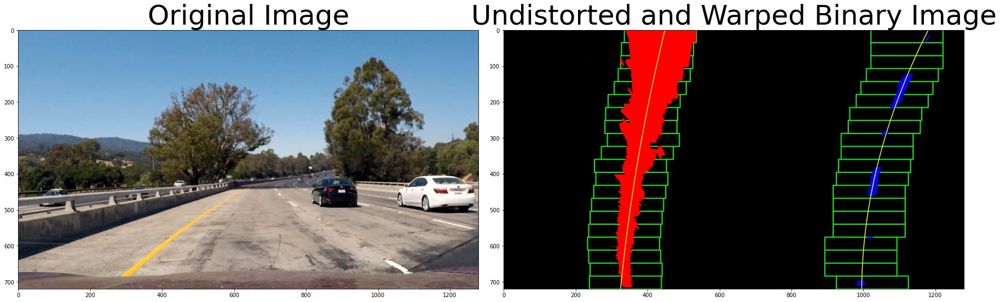

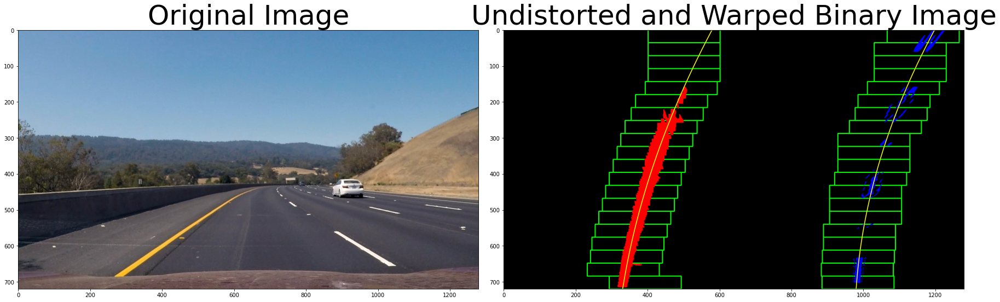

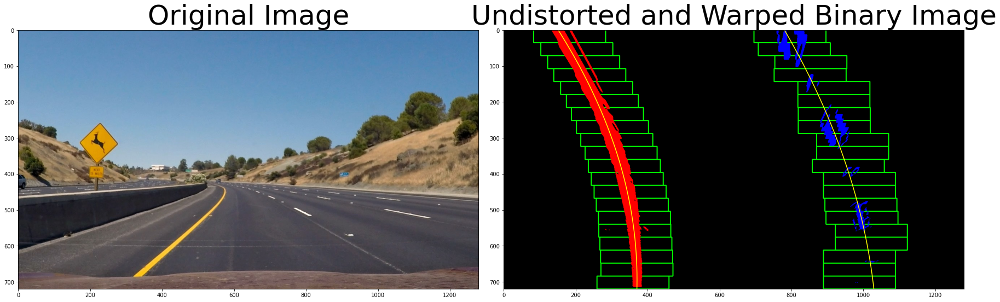

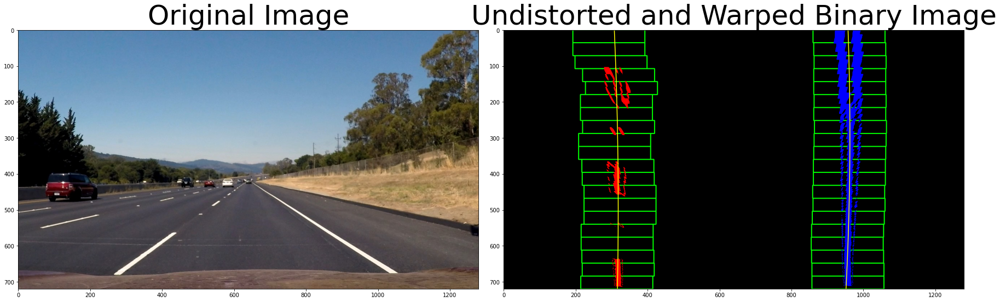

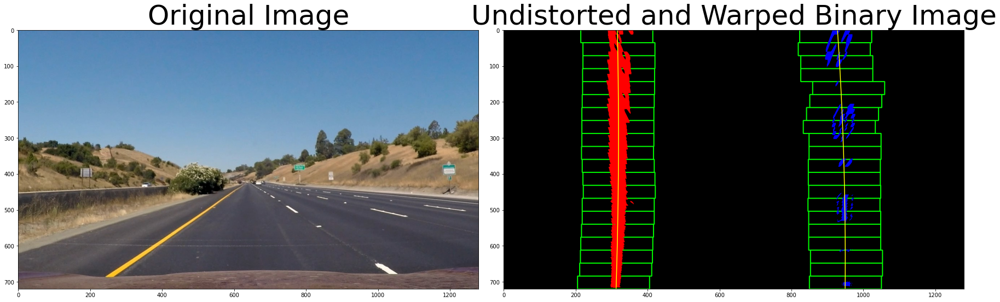

In [44]:
# Checking polynominal lane drawing on the warped masked binary outputs
images = glob.glob('test_images/*.jpg')
image = mpimg.imread(images[0]) 

img_size = (image.shape[1], image.shape[0])


for image in images:
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    img = mpimg.imread(image)
    
    result, result_binary = sobel_hls_threshold(img)
    
    masked_image_binary = region_of_interest(result_binary, vertices)

    top_down, perspective_M = corners_unwarp(masked_image_binary, mtx, dist, warp_corners)
    
    #warp_corners_ = [tuple(item) for item in warp_corners]

    out_img = fit_polynomial(top_down)

    f.tight_layout()
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(out_img, cmap='gray')
    ax2.set_title('Undistorted and Warped Binary Image', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)



In [ ]:
# !!! Change this later for frame based window lane searching

# FRAME NUMBER

# Load our image - this should be a new frame since last time!
binary_warped = mpimg.imread('warped_example.jpg')

# Polynomial fit values from the previous frame

def fit_poly(binary_warped, leftx, lefty, rightx, righty):
    global ploty, left_fit, right_fit
     ### TO-DO: Fit a second order polynomial to each with np.polyfit() ###
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0])
    ### TO-DO: Calc both polynomials using ploty, left_fit and right_fit ###
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    return left_fitx, right_fitx, ploty


def search_around_poly(binary_warped):
    global ploty, left_fit, right_fit
    # HYPERPARAMETER
    # Choose the width of the margin around the previous polynomial to search
    # The quiz grader expects 100 here, but feel free to tune on your own!
    margin = 100

    # Grab activated pixels
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    ### TO-DO: Set the area of search based on activated x-values ###
    ### within the +/- margin of our polynomial function ###
    ### Hint: consider the window areas for the similarly named variables ###
    ### in the previous quiz, but change the windows to our new search area ###
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
                    left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
                    left_fit[1]*nonzeroy + left_fit[2] + margin)))
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
                    right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
                    right_fit[1]*nonzeroy + right_fit[2] + margin)))
    
    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    # Fit new polynomials
    left_fit, right_fit, ploty = fit_poly(binary_warped, leftx, lefty, rightx, righty)
    
    ## Visualization ##
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fit-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fit+margin, 
                              ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fit-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fit+margin, 
                              ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    
    # Plot the polynomial lines onto the image
    plt.plot(left_fit, ploty, color='yellow')
    plt.plot(right_fit, ploty, color='yellow')
    ## End visualization steps ##
    
    return result

# Run image through the pipeline
# Note that in your project, you'll also want to feed in the previous fits
result = search_around_poly(binary_warped)

# View your output
plt.imshow(result)

4352.6685103996515 m 3114.7486564051023 m


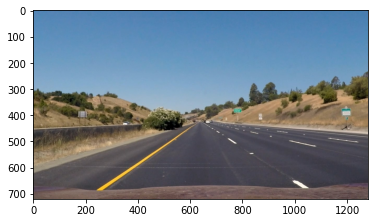

In [48]:
def measure_curvature_real():
    '''
    Calculates the curvature of polynomial functions in meters.
    '''
    left_fit_meter = [xm_per_pix / (ym_per_pix ** 2) * left_fit[0], (xm_per_pix / ym_per_pix) * left_fit[1], left_fit[2]]
    right_fit_meter = [xm_per_pix / (ym_per_pix ** 2) * right_fit[0], (xm_per_pix / ym_per_pix) * right_fit[1], right_fit[2]]
    # x= mx / (my ** 2) *a*(y**2)+(mx/my)*b*y+c
    
    # Define y-value where we want radius of curvature
    # We'll choose the maximum y-value, corresponding to the bottom of the image
    y_eval = np.max(ploty)
    
    # Calculation of R_curve (radius of curvature)
    left_curverad = ((1 + (2*left_fit_meter[0]*y_eval*ym_per_pix + left_fit_meter[1])**2)**1.5) / np.absolute(2*left_fit_meter[0])
    right_curverad = ((1 + (2*right_fit_meter[0]*y_eval*ym_per_pix + right_fit_meter[1])**2)**1.5) / np.absolute(2*right_fit_meter[0])
    
    return left_curverad, right_curverad


# Calculate the radius of curvature in meters for both lane lines
left_curverad, right_curverad = measure_curvature_real()

plt.imshow(img)
print(left_curverad, 'm', right_curverad, 'm')
# Should see values of 533.75 and 648.16 here, if using
# the default `generate_data` function with given seed number

In [ ]:
def process_image(image):
    global img_size, left_lane, right_lane
    
    if not img_size:
        img_size = (image.shape[1], image.shape[0])

    # Threshold
    result, result_binary = sobel_hls_threshold(image)
    # Mask
    masked_image_binary = region_of_interest(result_binary, vertices)
    # Warp
    top_down, perspective_M = corners_unwarp(masked_image_binary, mtx, dist, warp_corners)
    #warp_corners_ = [tuple(item) for item in warp_corners]

    
    # Get lines
    out_img = fit_polynomial(top_down)



In [40]:
# MAIN()

inp = input('calibrate? ')
if inp == '1':
    camera_calibration()
    get_warp_corners(show=True)  # if you need to check the lines on image change show=True 
else:
    get_warp_corners(show=False)  # if you need to check the lines on image change show=True 
dist_pickle = pickle.load(open('./calibration_pickle.p', 'rb'))
mtx = dist_pickle['mtx']
dist = dist_pickle['dist']
warp_corners = dist_pickle['warp_corners']

print('done')



frame_number = 0

img_size = None


ploty = None
left_fit = None
right_fit = None

# Define conversions in x and y from pixels space to meters
ym_per_pix = 30/720 # meters per pixel in y dimension
xm_per_pix = 3.7/700 # meters per pixel in x dimension

left_lane = Line()
right_lane = Line()
number_of_allowed_consecutive_failures = 1


output_video = '.video_outputs/video_outputs.mp4'
input_video = './project_video.mp4'
clip1 = VideoFileClip(input_video).subclip(0,5)
# clip1 = VideoFileClip(input_video)
white_clip = clip1.fl_image(process_image)
%time white_clip.write_videofile(output_video, audio=False)



In [51]:
# Define a class to receive the characteristics of each line detection
class Line():
    def __init__(self):
        # was the line detected in the last iteration?
        self.detected = False
        # numner of consecutive line detection failures
        self.number_of_failures = 0
        # x values of the last n fits of the line
        self.recent_xfitted = [] 
        #average x values of the fitted line over the last n iterations
        self.bestx = None     
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = None  
        #polynomial coefficients for the most recent fit
        self.current_fit = [np.array([False])]  
        #radius of curvature of the line in some units
        self.radius_of_curvature = None 
        #distance in meters of vehicle center from the line
        self.line_base_pos = None 
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float') 
        #x values for detected line pixels
        self.allx = None  
        #y values for detected line pixels
        self.ally = None  